In [1]:
from datetime import datetime
import pytz

print("Start:", datetime.now(pytz.timezone('US/Eastern')).strftime("%c"))

Start: Thu Aug 13 13:59:27 2020


In [2]:
%matplotlib inline

import numpy as np
import os
import cv2
import imageio

import matplotlib.pyplot as plt
import pandas as pd

from dataset import Dataset
from model import Model

import re
import glob

# Model Paramters and Simulations

In [3]:
%%capture

prefix = "classification_slex_212"

in_dir = os.path.join(os.path.abspath("."), "data", "slex")
out_dir = os.path.join(os.path.abspath("."), "{}_results".format(prefix))

test_set = Dataset(scale=1.0, shuffle=False, data_dir=in_dir,
                   rf1_x=36, rf1_y=24, rf1_offset_x=32, rf1_offset_y=20,
                   rf1_layout_x=4, rf1_layout_y=4, gauss_mask_sigma=1.0)

iter_n = 30 # default: 30
epoch_n = 500

zero_pad_len = len(str(epoch_n))

model = Model(iteration=iter_n, dataset=test_set)

# parameters
model.k_r = 0.005 # default: 0.0005
model.k_U_init = 0.001  # default: 0.005
model.k_U_decay_cycle = 40 # default: 40
model.k_U_decay_rate = 1.015 # default: 1.015

model.sigma_sq0 = 1.0 # default: 1.0
model.sigma_sq1 = 10.0 # default: 10.0
model.sigma_sq2 = 10.0 # default: 10.0
model.sigma_sq3 = 2.0 # default: 2.0

model.alpha1 = 1.0  # default: 1.0
model.alpha2 = 0.05 # default: 0.05
model.alpha3 = 0.05 # default: 0.05

model.lambda1 = 0.02 # default: 0.02
model.lambda2 = 0.0001 # default: 0.0001
model.lambda3 = 0.02 # default: 0.0001

In [4]:
%%capture

model.save(os.path.join(out_dir, "pretraining"))

In [5]:
%%capture

for i in range(epoch_n):
    # images are shuffled for each training epoch
    train_set = Dataset(scale=1.0, shuffle=True, data_dir=in_dir,
                   rf1_x=36, rf1_y=24, rf1_offset_x=32, rf1_offset_y=20,
                   rf1_layout_x=4, rf1_layout_y=4, gauss_mask_sigma=1.0)
    model.train(train_set)
    
    if i == 0 or i % 10 == 9:
        model.save(os.path.join(out_dir, "epoch_{:0>{}d}".format(i, zero_pad_len)))

# Plot Reconstructions of 10 Random Inputs

In [6]:
filenames = sorted(glob.glob(os.path.join(in_dir, "*.png")))

regex = re.compile(os.path.join(in_dir, "(?P<index>.*)_(?P<word>.*).png"))
f_index = [regex.match(x).group('index') for x in filenames]
f_word = [regex.match(x).group('word') for x in filenames]

loaded: ./classification_results_slex/pretraining


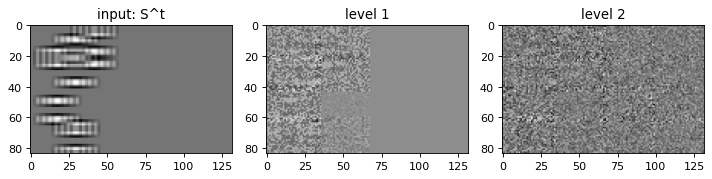

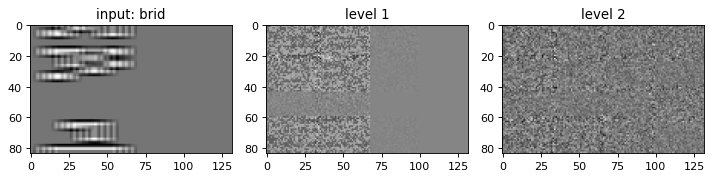

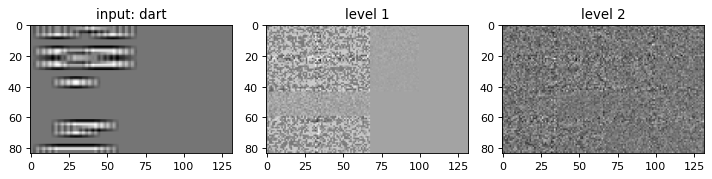

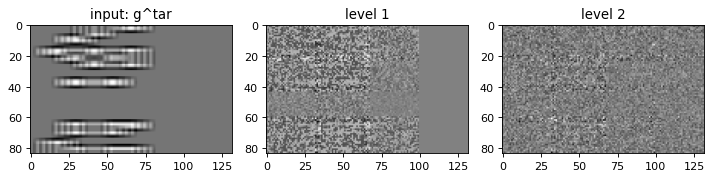

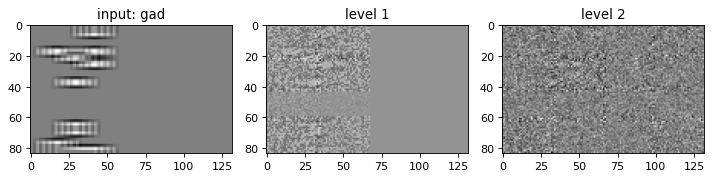

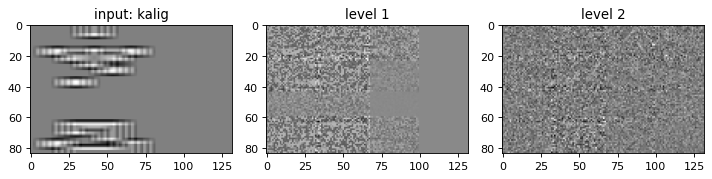

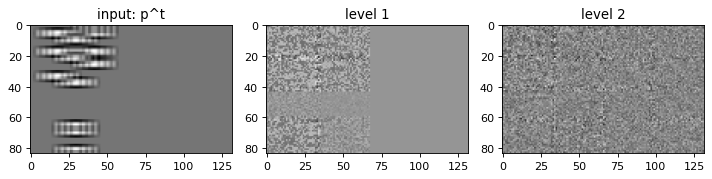

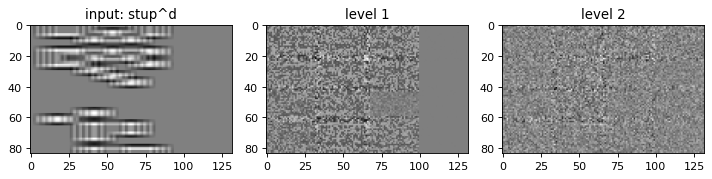

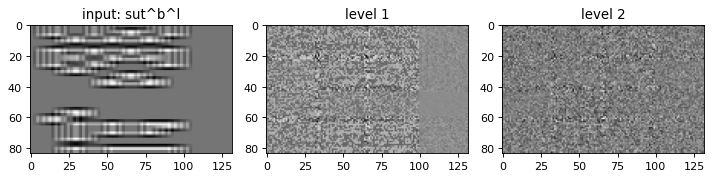

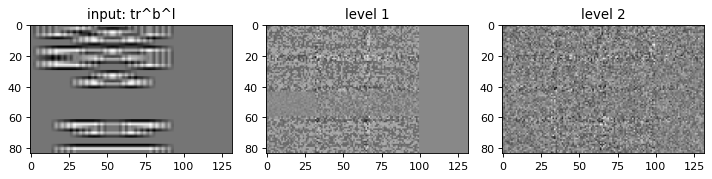

In [7]:
model.load(os.path.join(out_dir, "pretraining"))

# randomly choose 10 words to plot
word_select = sorted(np.random.choice(len(test_set.filtered_images), 10, replace=False))

for i in word_select:
    filtered_img = test_set.filtered_images[i]
    filtered_img = cv2.normalize(src=filtered_img, dst=None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_8U)

    inputs = test_set.get_rf1_patches(i)
    label = test_set.labels[i]
    r1, r2, r3, e1, e2, e3 = model.apply_input(inputs, label, training=False)
    level1_img = model.reconstruct(r1, level=1)
    level2_img = model.reconstruct(r2, level=2)
    level1_img = cv2.normalize(src=level1_img, dst=None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_8U)
    level2_img = cv2.normalize(src=level2_img, dst=None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_8U)
    
    plt.figure(figsize=(9, 3), dpi=80)

    plt.subplot(131)
    plt.title("input: {}".format(f_word[i]))
    plt.imshow(filtered_img, cmap="gray")

    plt.subplot(132)
    plt.title("level 1")
    plt.imshow(level1_img, cmap="gray")
    
    plt.subplot(133)
    plt.title("level 2")
    plt.imshow(level2_img, cmap="gray")

    plt.tight_layout()

loaded: ./classification_results_slex/epoch_499


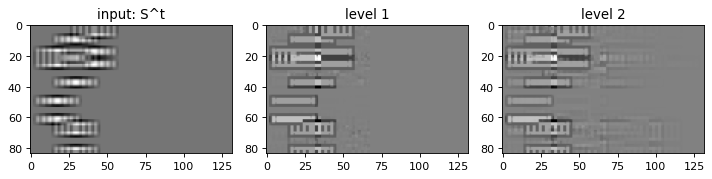

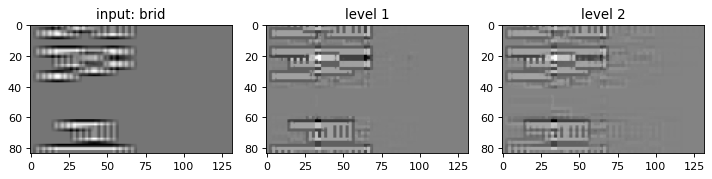

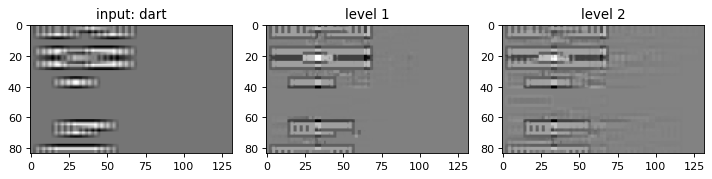

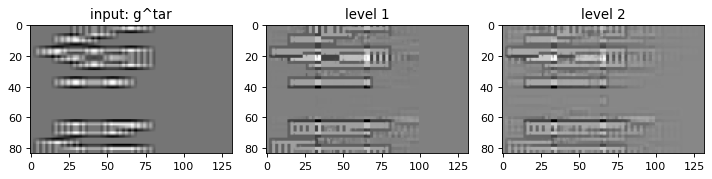

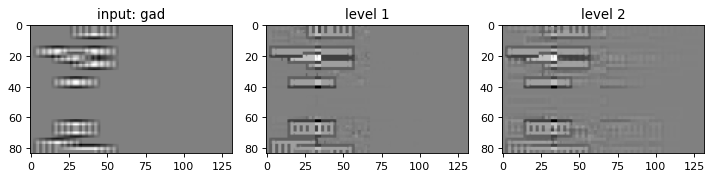

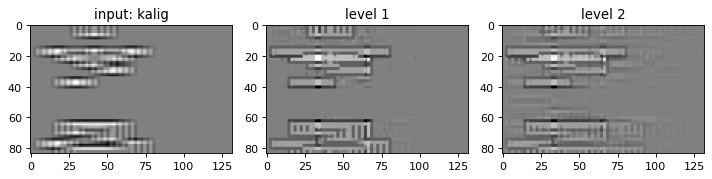

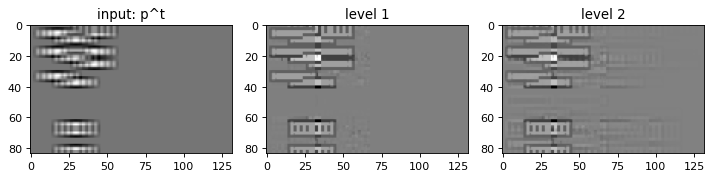

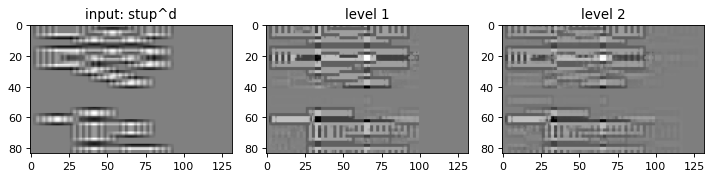

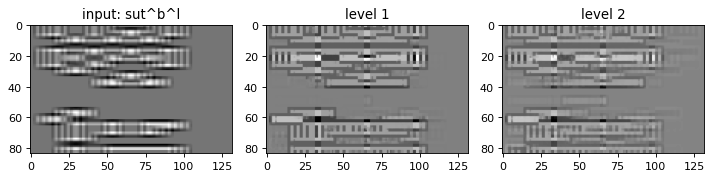

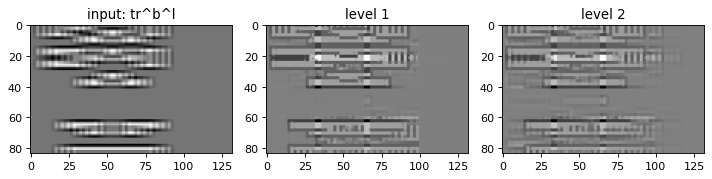

In [8]:
model.load(os.path.join(out_dir, "epoch_{:0>{}d}".format(max(range(epoch_n)), zero_pad_len)))

for i in word_select:
    filtered_img = test_set.filtered_images[i]
    filtered_img = cv2.normalize(src=filtered_img, dst=None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_8U)

    inputs = test_set.get_rf1_patches(i)
    label = test_set.labels[i]
    r1, r2, r3, e1, e2, e3 = model.apply_input(inputs, label, training=False)
    level1_img = model.reconstruct(r1, level=1)
    level2_img = model.reconstruct(r2, level=2)
    level1_img = cv2.normalize(src=level1_img, dst=None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_8U)
    level2_img = cv2.normalize(src=level2_img, dst=None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_8U)
    
    plt.figure(figsize=(9, 3), dpi=80)

    plt.subplot(131)
    plt.title("input: {}".format(f_word[i]))
    plt.imshow(filtered_img, cmap="gray")

    plt.subplot(132)
    plt.title("level 1")
    plt.imshow(level1_img, cmap="gray")
    
    plt.subplot(133)
    plt.title("level 2")
    plt.imshow(level2_img, cmap="gray")

    plt.tight_layout()

# Load Simulation Results as a Dataframe

In [9]:
%%capture

if os.path.exists(os.path.join(out_dir, "results.csv")):
    results_df = pd.read_csv(os.path.join(out_dir, "results.csv"))
else:
    results = {"epoch": [], "target": [], "iteration":[],
               "node": [], "node_word": [], "target_label": [], "activation": [],
               "target_n": [], "response_n": [], "accuracy": []}

    for i in range(epoch_n):
            if i == 0 or i % 10 == 9:
                model.load(os.path.join(out_dir, "epoch_{:0>{}d}".format(i, zero_pad_len)))

                for j in range(len(test_set.rf2_patches)):
                    for k in range(iter_n):
                        model.iteration = k+1
                        
                        inputs = test_set.get_rf1_patches(j)
                        label = test_set.labels[j]
                        r1, r2, r3, e1, e2, e3 = model.apply_input(inputs, label, training=False)

                        target_n = np.argmax(label)

                        if sum(r3 == r3.max()) != 1:
                            response_n = None
                        else:
                            response_n = np.argmax(r3)

                        if target_n == response_n:
                            accuracy = 1
                        else:
                            accuracy = 0

                        results["epoch"] += [i] * len(r3)
                        results["target"] += [f_word[target_n]] * len(r3)
                        results["iteration"] += [k] * len(r3)
                        results["node"] += list(range(len(r3)))
                        results["node_word"] += [f_word[x] for x in list(range(len(r3)))]
                        results["target_label"] += list(label)
                        results["activation"] += list(r3)
                        results["target_n"] += [target_n] * len(r3)
                        results["response_n"] += [response_n] * len(r3)
                        results["accuracy"] += [accuracy] * len(r3)

    results_df = pd.DataFrame.from_dict(results)
    results_df.to_csv(os.path.join(out_dir, "results.csv"), index=False)

In [10]:
def category_given_target(target, word):

    if target == word:
        category = "target"
    elif target[0:2] == word[0:2]:
        category = "cohort"
    elif target[1:] == word[1:]:
        category = "rhyme"
    elif word in target:
        category = "embedded"
    else:
        category = "other"

    return category

In [11]:
results_df["category"] = results_df.apply(lambda x: category_given_target(x["target"], x["node_word"]), axis = 1)
results_df.category = results_df.category.astype('category').cat.set_categories(['target', 'cohort', 'rhyme', 'other', 'embedded'])

In [12]:
results_df_all_iter = results_df
results_df = results_df[results_df.iteration == max(results_df.iteration)]

# Accuracy by Epoch

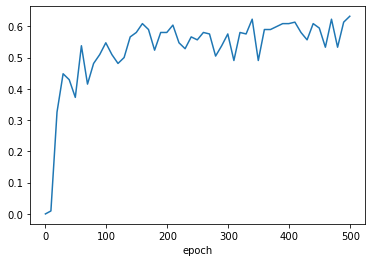

In [13]:
results_df.groupby('epoch')['accuracy'].mean().plot();

# Accuracy by Item

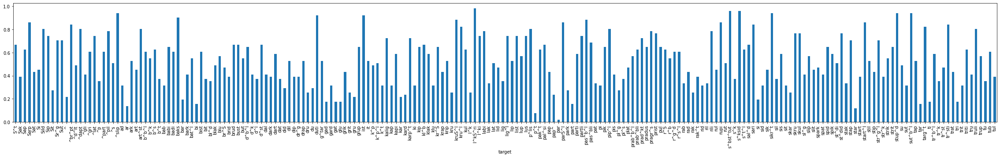

In [14]:
results_df.groupby('target')['accuracy'].mean().plot.bar(figsize=(40,5));

# Activation Over Epochs of Top 10 Activated Items for a Given Target

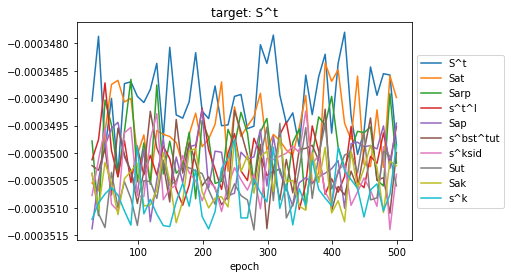

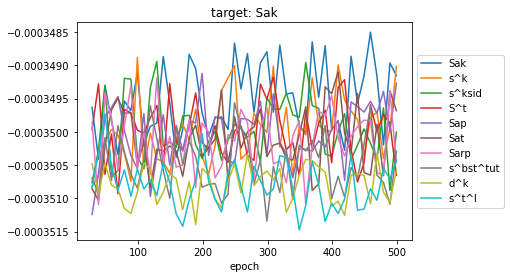

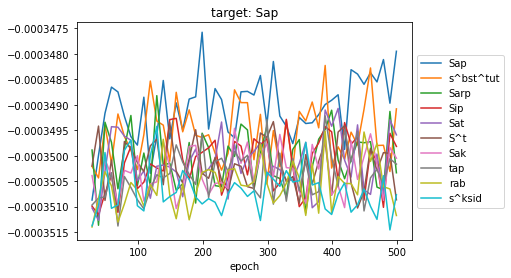

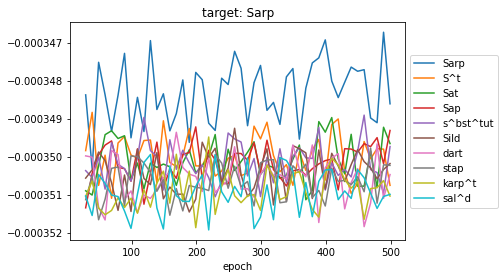

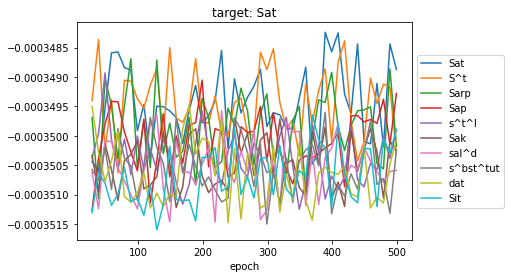

...

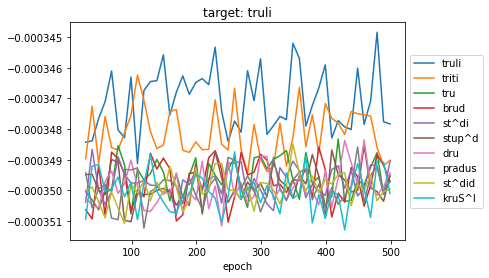

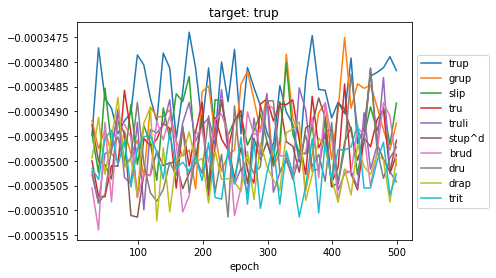

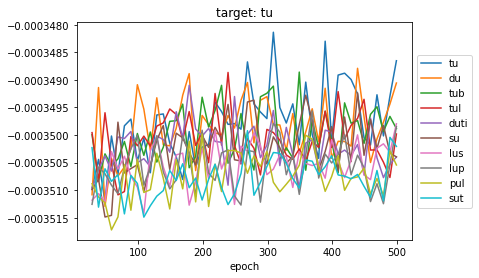

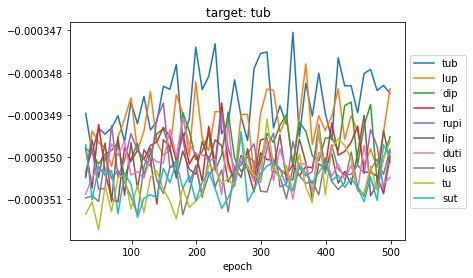

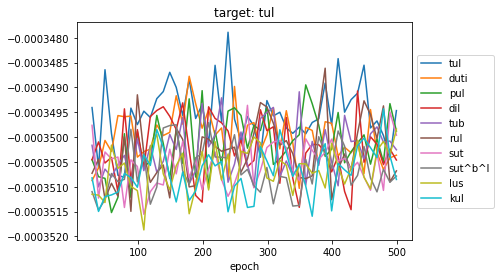

In [15]:
pd.set_option('precision', 10)
vector_len = len(test_set.labels)

for i in range(vector_len):
    results_df_select = results_df[(results_df.target_n == i) & (results_df.epoch > 20)]
    top_10 = results_df_select.groupby("node_word", as_index=False).mean().sort_values(by=["activation"], ascending=False).node_word[0:10]
    results_df_select = results_df_select.loc[results_df_select["node_word"].isin(top_10)]
    
    # order based on average activation values
    results_df_select.node_word = results_df_select.node_word.astype('category').cat.set_categories(top_10)

    # plot
    df_plot = results_df_select.groupby(["epoch","node_word"]).mean()["activation"].unstack().plot(title='target: {}'.format(f_word[i]));
    df_plot.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    plt.show()

# Activation by Category

## Average Across All Items Over Epoch

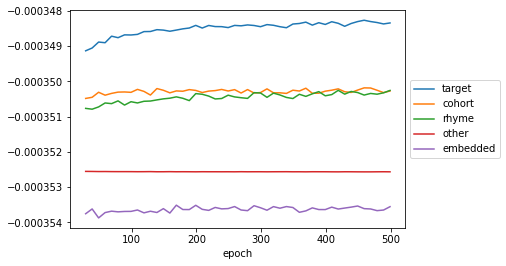

In [16]:
df_plot = results_df[results_df.epoch > 20].groupby(["epoch","category"]).mean()["activation"].unstack().plot();
df_plot.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()

## By Item Over Epoch

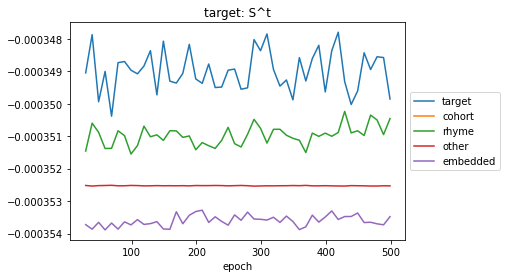

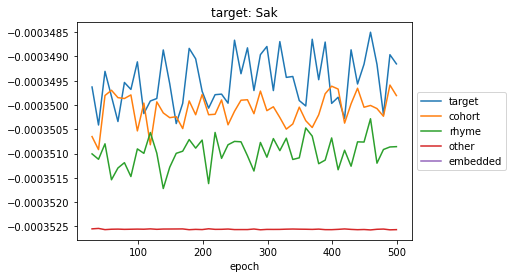

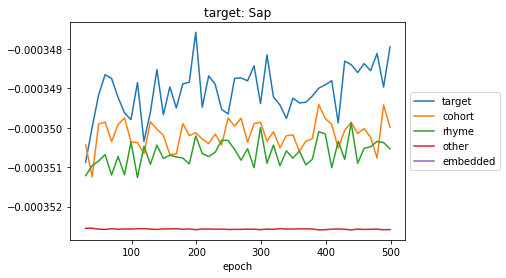

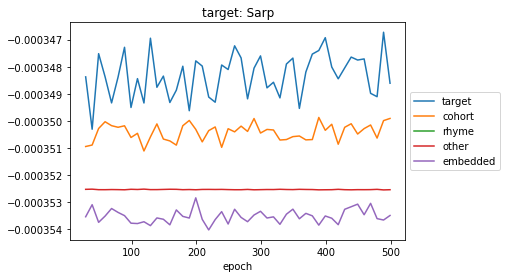

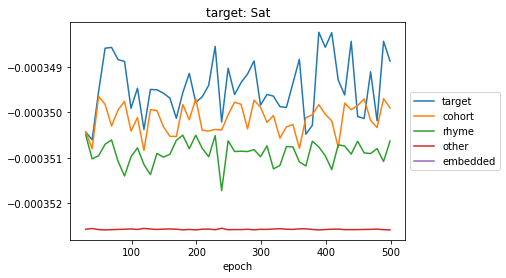

...

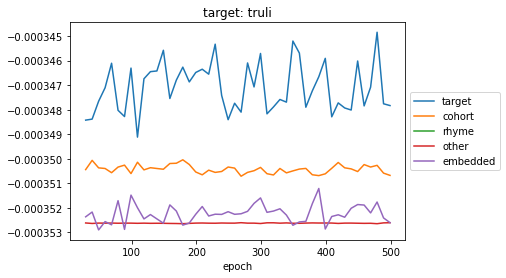

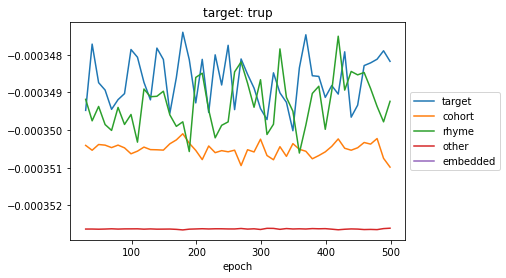

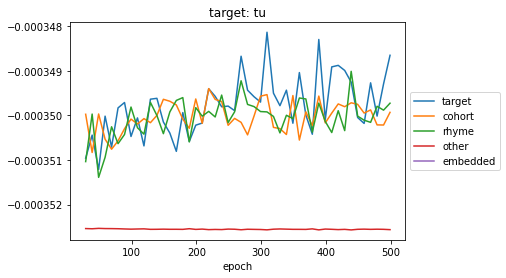

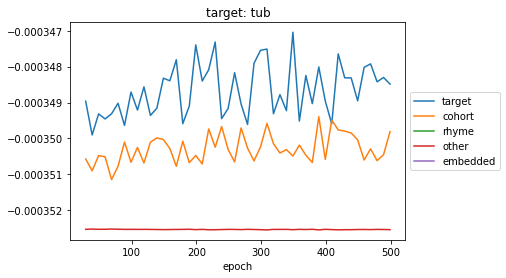

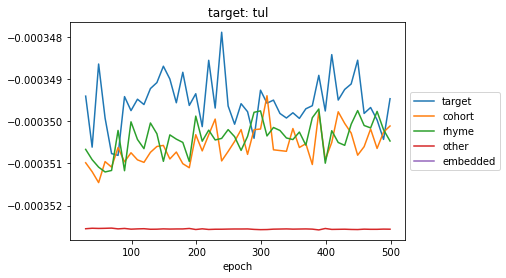

In [17]:
vector_len = len(test_set.labels)

for i in range(vector_len):
    df_plot = results_df[(results_df.target_n == i) & (results_df.epoch > 20)].groupby(["epoch","category"]).mean()["activation"].unstack().plot(title='target: {}'.format(f_word[i]));
    df_plot.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    plt.show()

# By Item Over Iteration

In [18]:
# vector_len = len(test_set.labels)

# for i in range(1):
#     df_i = results_df_all_iter[(results_df_all_iter.target_n == i) &
#                                (results_df_all_iter.epoch == max(results_df_all_iter.epoch)) &
#                               (results_df_all_iter.iteration >= 20)].groupby(["iteration","category"]).mean()["activation"].unstack()
#     df_i_plot = df_i.plot(title='target: {}'.format(f_word[i]), figsize=(20,20));
#     df_i_plot.legend(loc='center left', bbox_to_anchor=(1, 0.5))
#     plt.show()

# Relationships Between Classification Accuracy and Item Properties

In [19]:
target_acc = results_df.groupby('target')['accuracy'].mean()

In [20]:
slex_stats = pd.read_csv(os.path.join(in_dir, "slex.csv"))

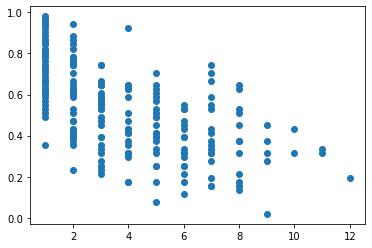

In [21]:
# accuracy by neighborhood density
target_N = slex_stats.sort_values(by=["Phono.orig"])["N_sum"].squeeze().values
plt.scatter(target_N, target_acc);

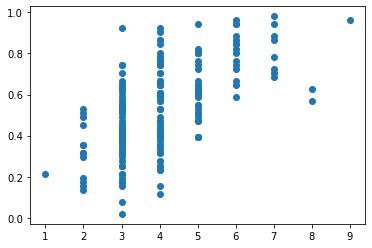

In [22]:
# accuracy by word length
target_len = slex_stats.sort_values(by=["Phono.orig"])["n_phon"].squeeze().values
plt.scatter(target_len, target_acc);

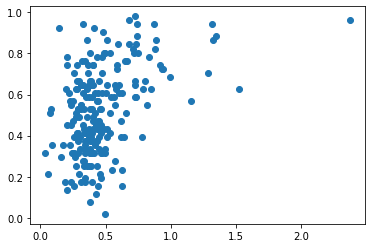

In [23]:
# accuracy by Pfreq_sum
target_Pfreq_sum = slex_stats.sort_values(by=["Phono.orig"])["Pfreq_sum"].squeeze().values
plt.scatter(target_Pfreq_sum, target_acc);

In [24]:
print("End:", datetime.now(pytz.timezone('US/Eastern')).strftime("%c"))

End: Fri Aug 14 15:35:13 2020
